# Repositorio: https://github.com/mariannaflores/mle 
### LABORATORIO 4

In [2]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

### FUNCIONES

In [3]:
def linear_cost(X, y, theta):
    h = X @ theta
    return ((y - h) ** 2).sum() / (2 * len(x))

In [4]:
def linear_cost_gradient(X, y, theta):
    h = X @ theta
    return ((h - y).T @ X).T / len(x)

In [5]:
def gradient_descent(
    X,
    y,
    theta_0,
    cost_function,
    cost_function_gradient,
    learning_rate = 0.01,
    threshold = 0.001,
    max_iter = 10000
):
    theta = theta_0
    iteration = 0
    costs = []
    thetas = []
    
    while np.linalg.norm(cost_function_gradient(X, y, theta)) > threshold and iteration < max_iter:
        iteration += 1
        theta = theta - (learning_rate * cost_function_gradient(X, y, theta))
        costs.append(cost_function(X, y, theta))
        thetas.append(theta.copy())
        
    return theta, costs, thetas


In [6]:
def hypothesis(X, theta):
    y1 = X @ theta
    return np.sum(y1, axis=1)

### DATOS

In [7]:
x = np.genfromtxt('/Users/maria/OneDrive/Documentos/mle/kc_house_data.csv',delimiter=',',skip_header=1)
print(type(x), x.shape)

<class 'numpy.ndarray'> (21613, 21)


In [8]:
y = np.array([x[:,2]]).T
X = np.array(x[:,5], copy=False, subok=True, ndmin=2).T
m = len(X)
unos = np.ones((m,1))
X = np.concatenate((unos,X), axis = 1)
m,n = X.shape
X

array([[1.00e+00, 1.18e+03],
       [1.00e+00, 2.57e+03],
       [1.00e+00, 7.70e+02],
       ...,
       [1.00e+00, 1.02e+03],
       [1.00e+00, 1.60e+03],
       [1.00e+00, 1.02e+03]])

In [9]:
theta_0 = np.random.rand(n, 1)

### CROSS-VALIDATION

In [10]:
TRAINING_SET_SIZE = 5000

# X CV
rows = X.shape[0]
indices = np.random.choice(rows, size=TRAINING_SET_SIZE, replace=False)
x_training = X[indices, :]
x_training2 = x_training**2
x_training3 = x_training**3

x_test = np.delete(X, indices, axis=None).reshape(19113,2, order='C')
x_test = x_test[0:16613,:]
x_test2 = x_test**2
x_test3 = x_test**3

# Y CV
rows2 = y.shape[0]
indices2 = np.random.choice(rows2, size=TRAINING_SET_SIZE, replace=False)
y_training = y[indices2, :]
y_test = np.delete(y, indices2, axis=None)

print(x_test.shape, y_test.shape)

(16613, 2) (16613,)


### POLINOMIO GRADO 1

In [11]:
t, c, ts = gradient_descent(
    x_training,
    y_training,
    theta_0,
    linear_cost,
    linear_cost_gradient,
    learning_rate=0.000000001,
    threshold=75
)

In [12]:
print('RESULTADOS \nTheta 0:          {:0.3f},\nTheta 1:          {:0.3f}'.format(t[0][0],t[1][0]))
print('Ecuacion polinomica lineal de precios de casas: {:0.3f} + {:0.3f} X1'.format(t[0][0],t[1][0]))

RESULTADOS 
Theta 0:          1.037,
Theta 1:          222.178
Ecuacion polinomica lineal de precios de casas: 1.037 + 222.178 X1


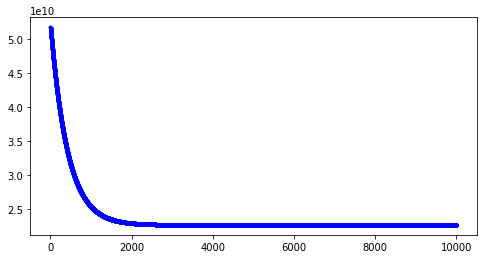

In [13]:
fig,ax = plt.subplots(figsize=(8,4))
_=ax.plot(range(10000),c,'b.')

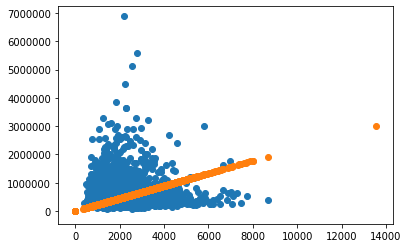

In [14]:
pred = hypothesis(x_test,t)
plt.figure()
plt.scatter(x=x_training[:,1],y= y_training)          
plt.scatter(x=x_test[:,1], y=pred)
plt.show()

### POLINOMIO GRADO 2

In [15]:
t1, c1, ts1 = gradient_descent(
    x_training2,
    y_training,
    theta_0,
    linear_cost,
    linear_cost_gradient,
    learning_rate=0.0000000000000001,
    threshold=75
)

In [16]:
print('RESULTADOS \nTheta 0:          {:0.3f},\nTheta 1:          {:0.3f}'.format(t1[0][0],t1[1][0]))
print('Ecuacion polinomica lineal de precios de casas: {:0.3f} + {:0.3f} X1'.format(t1[0][0],t1[1][0]))

RESULTADOS 
Theta 0:          0.743,
Theta 1:          0.053
Ecuacion polinomica lineal de precios de casas: 0.743 + 0.053 X1


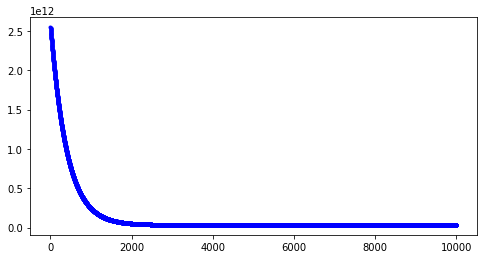

In [17]:
fig,ax = plt.subplots(figsize=(8,4))
_=ax.plot(range(10000),c1,'b.')

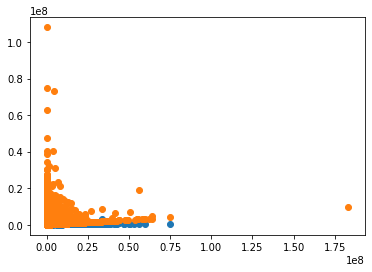

In [18]:
pred2 = hypothesis(x_test2,t1)
plt.figure()
plt.scatter(x=x_training2[:,1],y= y_training)          
plt.scatter(x=x_test2[:,1], y=pred2)
plt.show()

### POLINOMIO GRADO 3

In [19]:
t3, c3, ts3 = gradient_descent(
    x_training3,
    y_training,
    theta_0,
    linear_cost,
    linear_cost_gradient,
    learning_rate=0.000000000000000000000001,
    threshold=50
)

In [20]:
print('RESULTADOS \nTheta 0:          {:0.3f},\nTheta 1:          {:0.3f}'.format(t3[0][0],t3[1][0]))
print('Ecuacion polinomica lineal de precios de casas: {:0.3f} + {:0.3f} X1'.format(t3[0][0],t3[1][0]))

RESULTADOS 
Theta 0:          0.743,
Theta 1:          0.055
Ecuacion polinomica lineal de precios de casas: 0.743 + 0.055 X1


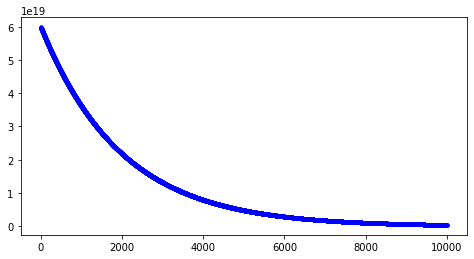

In [21]:
fig,ax = plt.subplots(figsize=(8,4))
_=ax.plot(range(10000),c3,'b.')

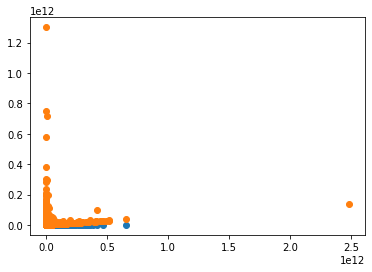

In [22]:
pred3 = hypothesis(x_test3,t3)
plt.figure()
plt.scatter(x=x_training3[:,1],y=y_training)          
plt.scatter(x=x_test3[:,1], y=pred3)
plt.show()

### ANALISIS

Segun los resultados y principalmente las graficas con cross validation, se puede concluir que el modelo mas atinado fue un polinomio de grado 3.

El uso de cross validation hacia variar los datos y fue claro definir el mejor modelo. Los graficos sin cv implican que el mejor modelo es el polinomio de grado 2. Esto podria ser por los datos completos y mas visualizables o porque el modelo estuviera overfitting

##### SIN CROSS-VALIDATION

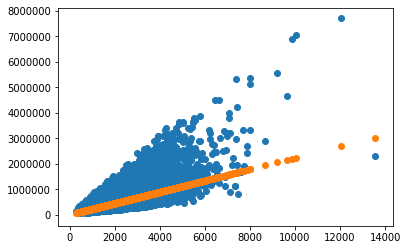

In [23]:
pred = hypothesis(X,t)
plt.figure()
plt.scatter(x=X[:,1],y= y)          
plt.scatter(x=X[:,1], y=pred)
plt.show()

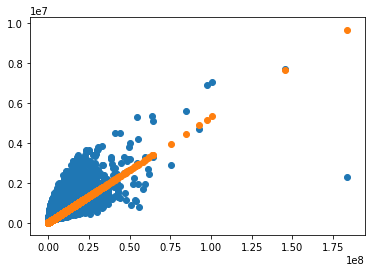

In [24]:
x2 = X**2
pred2 = hypothesis(x2,t1)
plt.figure()
plt.scatter(x=x2[:,1],y= y)          
plt.scatter(x=x2[:,1], y=pred2)
plt.show()

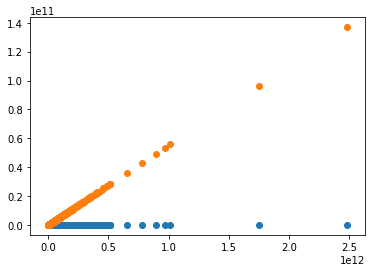

In [25]:
x3 = X**3
pred3 = hypothesis(x3,t3)
plt.figure()
plt.scatter(x=x3[:,1],y= y)          
plt.scatter(x=x3[:,1], y=pred3)
plt.show()